 # Sentiment Analysis 

## First, let's get to know the dataset.

1.Reading in the vegas reviews dataset (this is `df`)
2.Converted any columns that look like dates into Pandas datetime columns.
3.Read in the venue info dataset and merged it with the reviews dataset. (called the resulting dataframe `df`, i.e. write over the old `df`)

Answered the following for the resulting merged dataframe, `df`:
1. How many reviews are there?
1. How many unique hotels are there? Note `gd` is the ID variable for hotels on TripAdvisor.
1. What are the unique types of travel categories?
1. Plot a histogram of the review ratings. How would you describe the overall review ratings on TripAdvisor for Vegas resorts?

## Sentiment 

Used `TextBlob` library to compute the polarity and subjectivity of every review.

1. Compared the histogram of review polarity with review ratings. 
Aswered the following questions:
1.How are they different? Conclusion based on this difference about how people rate and how people write?
2. To what degree are polarity and subjectivity correlated with ratings?
 
Used a groupby + corr() statement to calculate the correlation between review ratings and polarity by travel category.
Answerd : In which categories are review polarity most and least correlated with ratings? 
And gave explanation for this relationship.

In [2]:
import pandas as pd
import numpy as np

In [3]:
df=pd.read_csv("vegas2015reviews.csv")

In [4]:
df

,Unnamed: 0,gd,helpful_num,location,mgrRspnDummy,mgr_res_date,mrtext,ratingDate,review_id,reviewrating,reviewtext,reviewtitle,stay_month,stay_year,travel_category,username
0,15044,g45963-d1123368,NaN,"Walnut Creek, California",0,NaN,NaN,2015-07-01,284818340,5,An excellent property! The rooms are very nice...,“At the top of its game”,6.0,2015.0,business,cadby
1,15045,g45963-d1123368,NaN,"Maidstone, United Kingdom",0,NaN,NaN,2015-07-01,284776986,5,My first visit to Las Vegas and WOW!! Whilst a...,“ wow!! ”,9.0,2014.0,couple,Sonia H
2,15046,g45963-d1123368,NaN,Brussels,0,NaN,NaN,2015-06-30,284187374,5,Some of the most beautiful hotel rooms in the ...,“ Mass market but luxery hotel at north end of...,6.0,2015.0,couple,Globaliser
3,15047,g45963-d1123368,NaN,"Colchester, United Kingdom",0,NaN,NaN,2015-06-13,279887884,5,"This Hotel is exceptional, its beautifully set...",“ Highlight of Vegas ”,5.0,2015.0,couple,Sharcoates
4,15058,g45963-d1123368,NaN,"Denver, Colorado, United States",0,NaN,NaN,2015-06-13,279841140,5,"My husband and I stayed here during a trip,to ...","“ Beautiful hotel, great location ”",6.0,2015.0,couple,Kimberly A
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46639,904218,g45963-d91925,3.0,"Washington DC, District of Columbia",1,2015-03-16,Thank you for your wonderful review. It is gre...,2015-03-15,259656436,5,Aria is one of the top hotels in the strip and...,“ Its worth it. ”,3.0,2015.0,solo,RexTanjuatco
46640,904229,g45963-d91925,NaN,"Portland, Oregon",1,2015-03-16,"Dear Bobbi, Thank you so much for choosing ARI...",2015-03-15,259650112,5,My husband and I just returned from Aria yeste...,“ Yet Another Visit ”,3.0,2015.0,couple,Bobbi S
46641,904240,g45963-d91925,NaN,MANCHESTER,1,2015-03-19,Thank you for your recommendation and sharing ...,2015-03-15,259639795,5,9 years since my last visit to Vegas & this ho...,“ 40th Birthday Trip ”,3.0,2015.0,friends,ZETAMANCHESTER
46642,904251,g45963-d91925,NaN,NaN,1,2015-03-16,"Dear Ramiro, Thank you for staying at ARIA to ...",2015-03-15,259601035,5,Stayed for one night for friends birthday. Gre...,“ BEST HOTEL IN LAS VEGAS!! ”,3.0,2015.0,friends,Ramiro G


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 46644 entries, 0 to 46643
Data columns (total 16 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Unnamed: 0       46644 non-null  int64  
 1   gd               46644 non-null  object 
 2   helpful_num      23576 non-null  float64
 3   location         39772 non-null  object 
 4   mgrRspnDummy     46644 non-null  int64  
 5   mgr_res_date     24957 non-null  object 
 6   mrtext           44220 non-null  object 
 7   ratingDate       46644 non-null  object 
 8   review_id        46644 non-null  int64  
 9   reviewrating     46644 non-null  int64  
 10  reviewtext       46644 non-null  object 
 11  reviewtitle      46644 non-null  object 
 12  stay_month       44649 non-null  float64
 13  stay_year        44649 non-null  float64
 14  travel_category  44649 non-null  object 
 15  username         45693 non-null  object 
dtypes: float64(3), int64(4), object(9)
memory usage: 5.7+ MB


In [6]:
df['ratingDate']= pd.to_datetime(df['ratingDate'])

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 46644 entries, 0 to 46643
Data columns (total 16 columns):
 #   Column           Non-Null Count  Dtype         
---  ------           --------------  -----         
 0   Unnamed: 0       46644 non-null  int64         
 1   gd               46644 non-null  object        
 2   helpful_num      23576 non-null  float64       
 3   location         39772 non-null  object        
 4   mgrRspnDummy     46644 non-null  int64         
 5   mgr_res_date     24957 non-null  object        
 6   mrtext           44220 non-null  object        
 7   ratingDate       46644 non-null  datetime64[ns]
 8   review_id        46644 non-null  int64         
 9   reviewrating     46644 non-null  int64         
 10  reviewtext       46644 non-null  object        
 11  reviewtitle      46644 non-null  object        
 12  stay_month       44649 non-null  float64       
 13  stay_year        44649 non-null  float64       
 14  travel_category  44649 non-null  objec

In [8]:
df_1=pd.read_csv("vegas_vinfo.csv")

In [9]:
df_1

,Unnamed: 0,ranking,rating_vol,rdetails,lnglat,rsubrating,vtype,amenities,details,v_name,rating_cat,gd
0,0,"[10, 33]",60.0,NaN,"[-115.06332, 36.1191]",{},Hotel_Review,{'Services': 'Free Parking Banquet Room Self-S...,"{'Number of rooms:': '398 ', 'Address:': '3890...",Las Vegas RV Resort,4.0,g45963-d3600552
1,1,"[209, 267]",63.0,NaN,"[-115.08308, 36.127922]",{},Hotel_Review,{'Things to do': 'Pool Fitness Center with Gym...,"{'Address:': '4240 Boulder Hwy, Las Vegas, NV ...",Crossland Economy Studios - Las Vegas - Boulde...,2.5,g45963-d97850
2,2,"[197, 267]",100.0,NaN,"[-115.19604, 36.20166]",{},Hotel_Review,"{'Room types': 'Non-Smoking Rooms ', 'Services...","{'Address:': '2400 N Rancho Dr, Las Vegas, NV ...",Fiesta Rancho Hotel and Casino,2.5,g45963-d121329
3,3,"[228, 267]",27.0,NaN,"[-115.19868, 36.201473]",{},Hotel_Review,"{'Things to do': 'Pool ', 'About the property'...",{'Also Known As:': 'Budget Suites Of America N...,Budget Suites of America North Rancho Drive,1.5,g45963-d91750
4,4,"[1, 33]",271.0,NaN,"[-115.1785, 36.040703]",{},Hotel_Review,{'Services': 'Self-Serve Laundry Free Parking ...,{'Also Known As:': 'Oasis Las Vegas Rv Hotel L...,Oasis Las Vegas RV Resort,4.5,g45963-d226809
...,...,...,...,...,...,...,...,...,...,...,...,...
232,232,"[26, 267]",1965.0,NaN,"[-115.17187, 36.11503]",{},Hotel_Review,{'Things to do': 'Pool Restaurant Bar/Lounge C...,"{'Address:': '3595 Las Vegas Boulevard South, ...",The Cromwell,4.5,g45963-d6537691
233,233,"[47, 267]",3007.0,NaN,"[-115.195, 36.11422]",{},Hotel_Review,{'Things to do': 'Fitness Center with Gym / Wo...,"{'Address:': '4321 West Flamingo Road, Las Veg...",Palms Casino Resort,4.0,g45963-d208820
234,234,"[100, 267]",546.0,NaN,"[-115.14454, 36.1732]",{},Hotel_Review,{'Things to do': 'Pool Restaurant Casino and G...,"{'Address:': '12 E Ogden Ave, Las Vegas, NV 89...",California Hotel,3.5,g45963-d91763
235,235,"[2, 33]",727.0,NaN,"[-115.21856, 36.113987]",{},Hotel_Review,{'Room types': 'Kitchenette Suites Non-Smoking...,"{'Address:': '5625 W Flamingo Rd, Las Vegas, N...",Westgate Flamingo Bay Resort,4.0,g45963-d234835


In [10]:
df_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 237 entries, 0 to 236
Data columns (total 12 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  237 non-null    int64  
 1   ranking     235 non-null    object 
 2   rating_vol  235 non-null    float64
 3   rdetails    0 non-null      float64
 4   lnglat      226 non-null    object 
 5   rsubrating  237 non-null    object 
 6   vtype       237 non-null    object 
 7   amenities   237 non-null    object 
 8   details     235 non-null    object 
 9   v_name      236 non-null    object 
 10  rating_cat  235 non-null    float64
 11  gd          237 non-null    object 
dtypes: float64(3), int64(1), object(8)
memory usage: 22.3+ KB


In [11]:
df

,Unnamed: 0,gd,helpful_num,location,mgrRspnDummy,mgr_res_date,mrtext,ratingDate,review_id,reviewrating,reviewtext,reviewtitle,stay_month,stay_year,travel_category,username
0,15044,g45963-d1123368,NaN,"Walnut Creek, California",0,NaN,NaN,2015-07-01,284818340,5,An excellent property! The rooms are very nice...,“At the top of its game”,6.0,2015.0,business,cadby
1,15045,g45963-d1123368,NaN,"Maidstone, United Kingdom",0,NaN,NaN,2015-07-01,284776986,5,My first visit to Las Vegas and WOW!! Whilst a...,“ wow!! ”,9.0,2014.0,couple,Sonia H
2,15046,g45963-d1123368,NaN,Brussels,0,NaN,NaN,2015-06-30,284187374,5,Some of the most beautiful hotel rooms in the ...,“ Mass market but luxery hotel at north end of...,6.0,2015.0,couple,Globaliser
3,15047,g45963-d1123368,NaN,"Colchester, United Kingdom",0,NaN,NaN,2015-06-13,279887884,5,"This Hotel is exceptional, its beautifully set...",“ Highlight of Vegas ”,5.0,2015.0,couple,Sharcoates
4,15058,g45963-d1123368,NaN,"Denver, Colorado, United States",0,NaN,NaN,2015-06-13,279841140,5,"My husband and I stayed here during a trip,to ...","“ Beautiful hotel, great location ”",6.0,2015.0,couple,Kimberly A
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46639,904218,g45963-d91925,3.0,"Washington DC, District of Columbia",1,2015-03-16,Thank you for your wonderful review. It is gre...,2015-03-15,259656436,5,Aria is one of the top hotels in the strip and...,“ Its worth it. ”,3.0,2015.0,solo,RexTanjuatco
46640,904229,g45963-d91925,NaN,"Portland, Oregon",1,2015-03-16,"Dear Bobbi, Thank you so much for choosing ARI...",2015-03-15,259650112,5,My husband and I just returned from Aria yeste...,“ Yet Another Visit ”,3.0,2015.0,couple,Bobbi S
46641,904240,g45963-d91925,NaN,MANCHESTER,1,2015-03-19,Thank you for your recommendation and sharing ...,2015-03-15,259639795,5,9 years since my last visit to Vegas & this ho...,“ 40th Birthday Trip ”,3.0,2015.0,friends,ZETAMANCHESTER
46642,904251,g45963-d91925,NaN,NaN,1,2015-03-16,"Dear Ramiro, Thank you for staying at ARIA to ...",2015-03-15,259601035,5,Stayed for one night for friends birthday. Gre...,“ BEST HOTEL IN LAS VEGAS!! ”,3.0,2015.0,friends,Ramiro G


In [12]:
df=pd.concat([df, df_1], axis=0)

In [13]:
df

,Unnamed: 0,gd,helpful_num,location,mgrRspnDummy,mgr_res_date,mrtext,ratingDate,review_id,reviewrating,...,ranking,rating_vol,rdetails,lnglat,rsubrating,vtype,amenities,details,v_name,rating_cat
0,15044,g45963-d1123368,NaN,"Walnut Creek, California",0.0,NaN,NaN,2015-07-01,284818340.0,5.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,15045,g45963-d1123368,NaN,"Maidstone, United Kingdom",0.0,NaN,NaN,2015-07-01,284776986.0,5.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,15046,g45963-d1123368,NaN,Brussels,0.0,NaN,NaN,2015-06-30,284187374.0,5.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,15047,g45963-d1123368,NaN,"Colchester, United Kingdom",0.0,NaN,NaN,2015-06-13,279887884.0,5.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,15058,g45963-d1123368,NaN,"Denver, Colorado, United States",0.0,NaN,NaN,2015-06-13,279841140.0,5.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
232,232,g45963-d6537691,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,...,"[26, 267]",1965.0,NaN,"[-115.17187, 36.11503]",{},Hotel_Review,{'Things to do': 'Pool Restaurant Bar/Lounge C...,"{'Address:': '3595 Las Vegas Boulevard South, ...",The Cromwell,4.5
233,233,g45963-d208820,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,...,"[47, 267]",3007.0,NaN,"[-115.195, 36.11422]",{},Hotel_Review,{'Things to do': 'Fitness Center with Gym / Wo...,"{'Address:': '4321 West Flamingo Road, Las Veg...",Palms Casino Resort,4.0
234,234,g45963-d91763,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,...,"[100, 267]",546.0,NaN,"[-115.14454, 36.1732]",{},Hotel_Review,{'Things to do': 'Pool Restaurant Casino and G...,"{'Address:': '12 E Ogden Ave, Las Vegas, NV 89...",California Hotel,3.5
235,235,g45963-d234835,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,...,"[2, 33]",727.0,NaN,"[-115.21856, 36.113987]",{},Hotel_Review,{'Room types': 'Kitchenette Suites Non-Smoking...,"{'Address:': '5625 W Flamingo Rd, Las Vegas, N...",Westgate Flamingo Bay Resort,4.0


In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 46881 entries, 0 to 236
Data columns (total 26 columns):
 #   Column           Non-Null Count  Dtype         
---  ------           --------------  -----         
 0   Unnamed: 0       46881 non-null  int64         
 1   gd               46881 non-null  object        
 2   helpful_num      23576 non-null  float64       
 3   location         39772 non-null  object        
 4   mgrRspnDummy     46644 non-null  float64       
 5   mgr_res_date     24957 non-null  object        
 6   mrtext           44220 non-null  object        
 7   ratingDate       46644 non-null  datetime64[ns]
 8   review_id        46644 non-null  float64       
 9   reviewrating     46644 non-null  float64       
 10  reviewtext       46644 non-null  object        
 11  reviewtitle      46644 non-null  object        
 12  stay_month       44649 non-null  float64       
 13  stay_year        44649 non-null  float64       
 14  travel_category  44649 non-null  object 

There are 46644 reviews , calculated by considering non null review_id because I assume those are unique 

In [15]:
arr=df['gd'].unique()

In [16]:
x=len(arr)

In [17]:
x

237

In [18]:
arr1=df['travel_category'].unique()

In [19]:
y=len(arr1)

In [20]:
y

6

There are 237 unique hotels and 6 unique travel categories.

array([[<AxesSubplot:title={'center':'reviewrating'}>]], dtype=object)

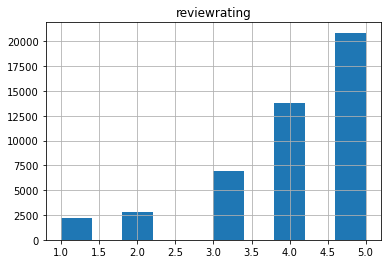

In [21]:
df.hist(column='reviewrating')

In [22]:
df['reviewrating'].mean()

4.036210445073321

In [23]:
df['reviewrating'].mode()

0    5.0
dtype: float64

overall review ratings on TripAdvisor for Vegas resorts seems to be really high with most resorts rated as 5 , which is the highest rating , the avg rating for a resort in vegas seems to be 4.03 on TripAdvisor. This means according to TripAdvisor Vegas has v good resorts.

In [24]:
from textblob import TextBlob

In [25]:
tweet1=df['reviewtext']


In [26]:
reviews=np.array(tweet1) 

In [27]:
reviews.shape

(46881,)

In [28]:
review = 'WordPress.com works really well with Google for a great SEO ranking.'
blob = TextBlob(review)
for sentence in blob.sentences:
    print(sentence.sentiment)

Sentiment(polarity=0.5, subjectivity=0.475)


In [29]:
r=sentence.sentiment

In [30]:
r

Sentiment(polarity=0.5, subjectivity=0.475)

In [31]:
#df['polarity']

In [32]:
r=[]
for review in reviews:
    blob = TextBlob(review)
    for sentence in blob.sentences:
        r=sentence.sentiment
       
        
        print(sentence.sentiment)
        
    

Sentiment(polarity=1.0, subjectivity=1.0)
Sentiment(polarity=0.78, subjectivity=1.0)
Sentiment(polarity=0.5, subjectivity=0.75)
Sentiment(polarity=0.375, subjectivity=0.5)
Sentiment(polarity=0.4125, subjectivity=0.6)
Sentiment(polarity=0.7, subjectivity=0.9)
Sentiment(polarity=0.16, subjectivity=0.5399999999999999)
Sentiment(polarity=0.203125, subjectivity=0.6666666666666666)
Sentiment(polarity=0.24, subjectivity=0.835)
Sentiment(polarity=0.0, subjectivity=0.0)
Sentiment(polarity=-0.234375, subjectivity=0.5)
Sentiment(polarity=0.0, subjectivity=0.125)
Sentiment(polarity=0.25625, subjectivity=0.55)
Sentiment(polarity=0.675, subjectivity=0.75)
Sentiment(polarity=0.0, subjectivity=0.0)
Sentiment(polarity=0.08333333333333333, subjectivity=0.24166666666666667)
Sentiment(polarity=0.11458333333333334, subjectivity=0.3666666666666667)
Sentiment(polarity=0.0, subjectivity=0.1)
Sentiment(polarity=0.78, subjectivity=1.0)
Sentiment(polarity=0.5, subjectivity=1.0)
Sentiment(polarity=0.45, subjectiv

TypeError: The `text` argument passed to `__init__(text)` must be a string, not <class 'float'>

In [ ]:

df['reviewtext']= df['reviewtext'].astype(str) #Make sure about the correct data type
pol = lambda x: TextBlob(x).sentiment.polarity
df['polarity'] = df['reviewtext'].apply(pol) # depending on the size of your data, this step may take some time.
import matplotlib.pyplot as plt
import seaborn as sns
num_bins = 50
plt.figure(figsize=(10,6))
n, bins, patches = plt.hist(df.polarity, num_bins, facecolor='blue', alpha=0.5)
plt.xlabel('Polarity')
plt.ylabel('Number of Reviews')
plt.title('Histogram of Polarity Score')
plt.show();

Vast majority of the sentiment polarity scores are greater than zero, means most of them are pretty positiveVast majority of the sentiment polarity scores are greater than zero, means most of them are pretty positive,moreover The ratings are in align with the polarity score, that is, most of the ratings are pretty high at 4 or 5 ranges.

In [ ]:
df[['polarity', 'subjectivity']] = df['reviewtext'].apply(lambda Text: pd.Series(TextBlob(Text).sentiment))

In [ ]:
df[['polarity', 'subjectivity']]

In [ ]:
df.groupby('gd')[['polarity','reviewrating']].corr()

In [ ]:
df.groupby('gd')[['subjectivity','reviewrating']].corr().iloc[0::2,-1]

In [ ]:
# degree of correlataion 
x=np.array(df['polarity'])
y=np.array(df['subjectivity'])
z=np.array(df['reviewrating'])

In [ ]:
z

In [ ]:
x.std()

In [ ]:
#degree of correlataion between polarity and reviewrating

In [ ]:
x_s=[] #standardizing x
for i in range(0,len(x)) :
    
    x_s.append((x[i]-x.mean())/x.std())

In [ ]:
x_s

In [ ]:
y_s=[] #standardizing x
for i in range(0,len(y)) :
    
    y_s.append((y[i]-y.mean())/y.std())

In [ ]:
z_s=[] #standardizing z
for i in range(0,len(z)) :
    z_s.append((z[i]-z.mean())/z.std())
    


In [ ]:
z.std()

In [ ]:
#correlation x & z

In [ ]:
x_s * z_s #tried to calculate degree of coreelation between review rating and polarity without using correlation function
# I know I am doing something worng but I don't know what exactly that is. 

In [77]:
groups = list(['polarity', 'subjectivity', 'reviewrating'])
df2 = pd.DataFrame()
for i in range( len(groups)-1): 
    df2 = df2.append( df.groupby('gd')[groups].corr().stack()
                        .loc[:,groups[i],groups[i+1]:].reset_index() )

df2.columns = ['gd', 'polarity', 'reviewrating', 'corr']
df2.set_index(['gd','polarity','reviewrating']).sort_index()

corr
gd              polarity     reviewrating          
g45963-d1022061 polarity     reviewrating  0.564630
                             subjectivity  0.568060
                subjectivity reviewrating  0.252959
g45963-d111709  polarity     reviewrating  0.600688
                             subjectivity  0.523824
...                                             ...
g45963-d97786   polarity     subjectivity  0.467680
                subjectivity reviewrating  0.233345
g45963-d97815   polarity     reviewrating  0.652000
                             subjectivity  0.360522
                subjectivity reviewrating  0.194807

[102 rows x 1 columns]

Use a groupby + corr() statement to calculate the correlation between review ratings and polarity by travel category. In which categories are review polarity most and least correlated with ratings? Any explanation for this relationship?

In [78]:
df.groupby('travel_category')[['polarity','reviewrating']].corr()

polarity  reviewrating
travel_category                                     
business        polarity      1.000000      0.623229
                reviewrating  0.623229      1.000000
couple          polarity      1.000000      0.568238
                reviewrating  0.568238      1.000000
family          polarity      1.000000      0.599097
                reviewrating  0.599097      1.000000
friends         polarity      1.000000      0.595152
                reviewrating  0.595152      1.000000
solo            polarity      1.000000      0.536387
                reviewrating  0.536387      1.000000

A correlation coefficient greater than zero indicates a positive relationship while a value less than zero signifies a negative relationship. People who travel Buisness class give the best reviews as opposed to people who travel solo. 